In [2]:
class_names = ['Roses', 'Magnolias', 'Lilies', 'Sunflowers', 'Orchids', 
               'Marigold', 'Hibiscus', 'Firebush', 'Pentas', 'Bougainvillea']

import numpy as np
import numpy.random as npr
import matplotlib.pyplot as plt
%matplotlib inline
plt.style.use('bmh')

# Loading Training Data
X_train_full = np.load('flower_species_classification/data_train.npy').T
t_train_full = np.load('flower_species_classification/labels_train.npy')

print(X_train_full.shape, t_train_full.shape)


(1658, 270000) (1658,)


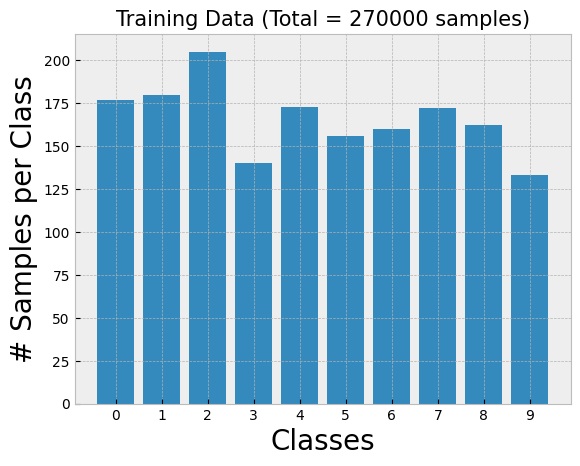

In [2]:
# Counting number samples per class
vals, counts = np.unique(t_train_full, return_counts=True)

plt.bar(vals, counts)
plt.xticks(range(10),range(10))
plt.xlabel('Classes',size=20)
plt.ylabel('# Samples per Class', size=20)
plt.title('Training Data (Total = '+str(X_train_full.shape[1])+' samples)',size=15);

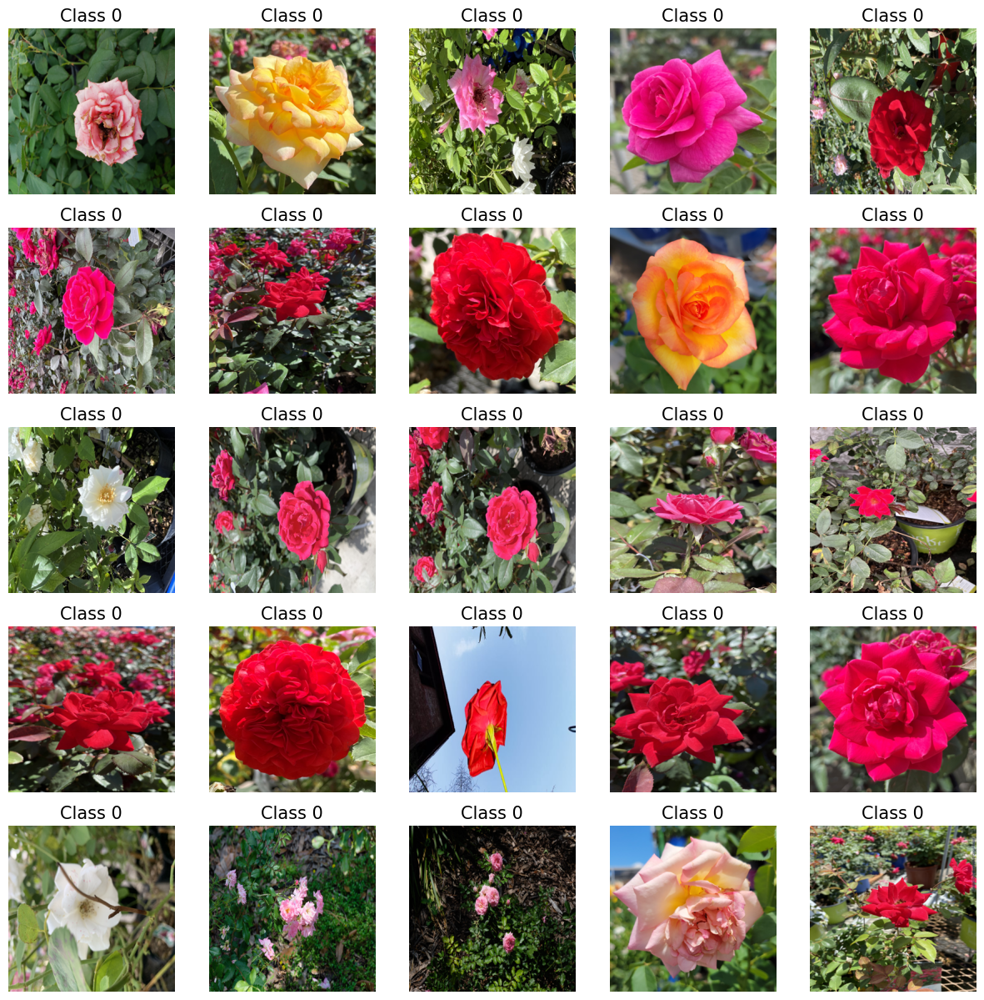

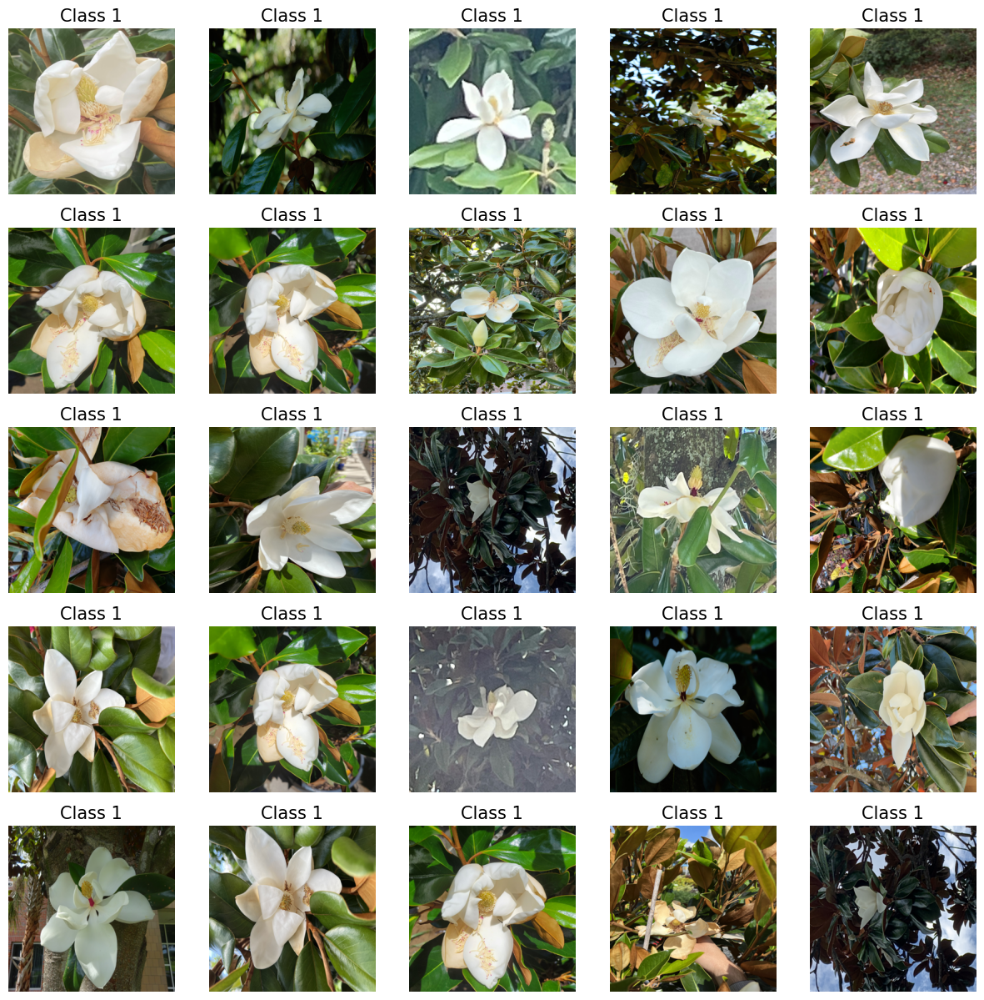

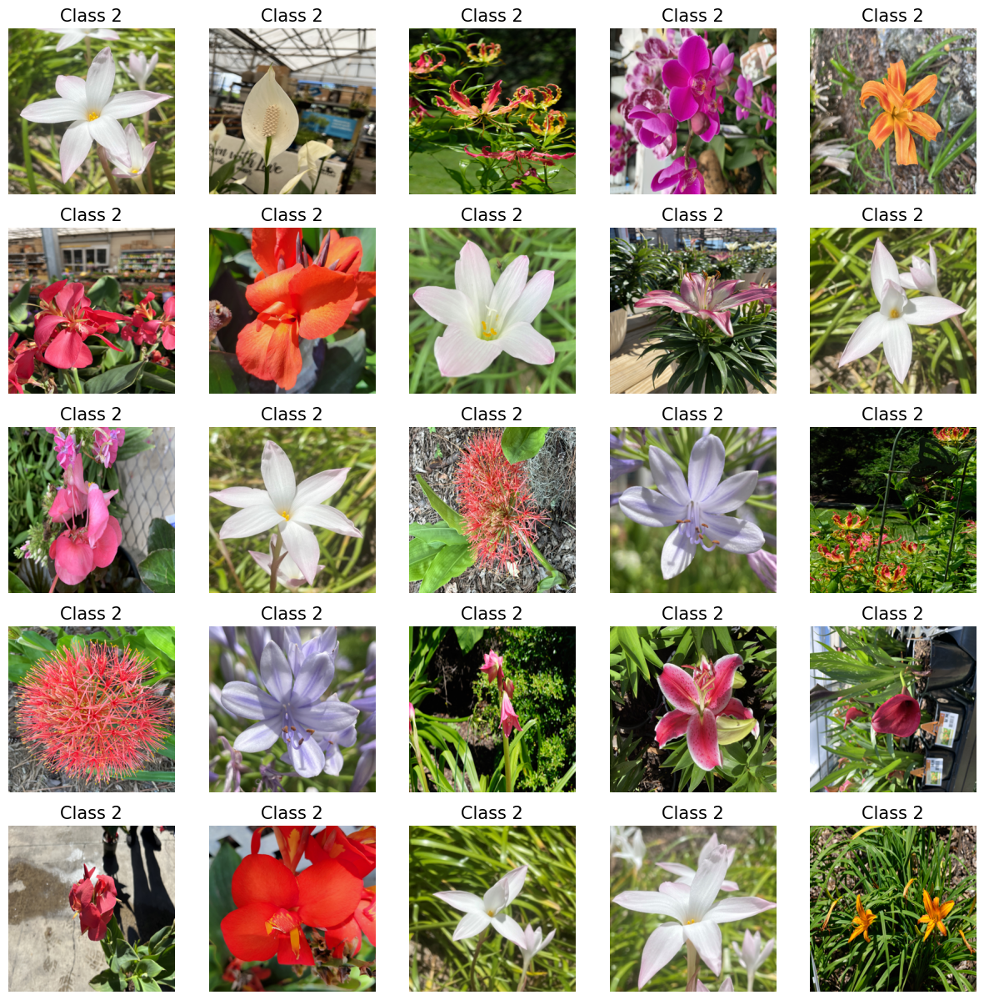

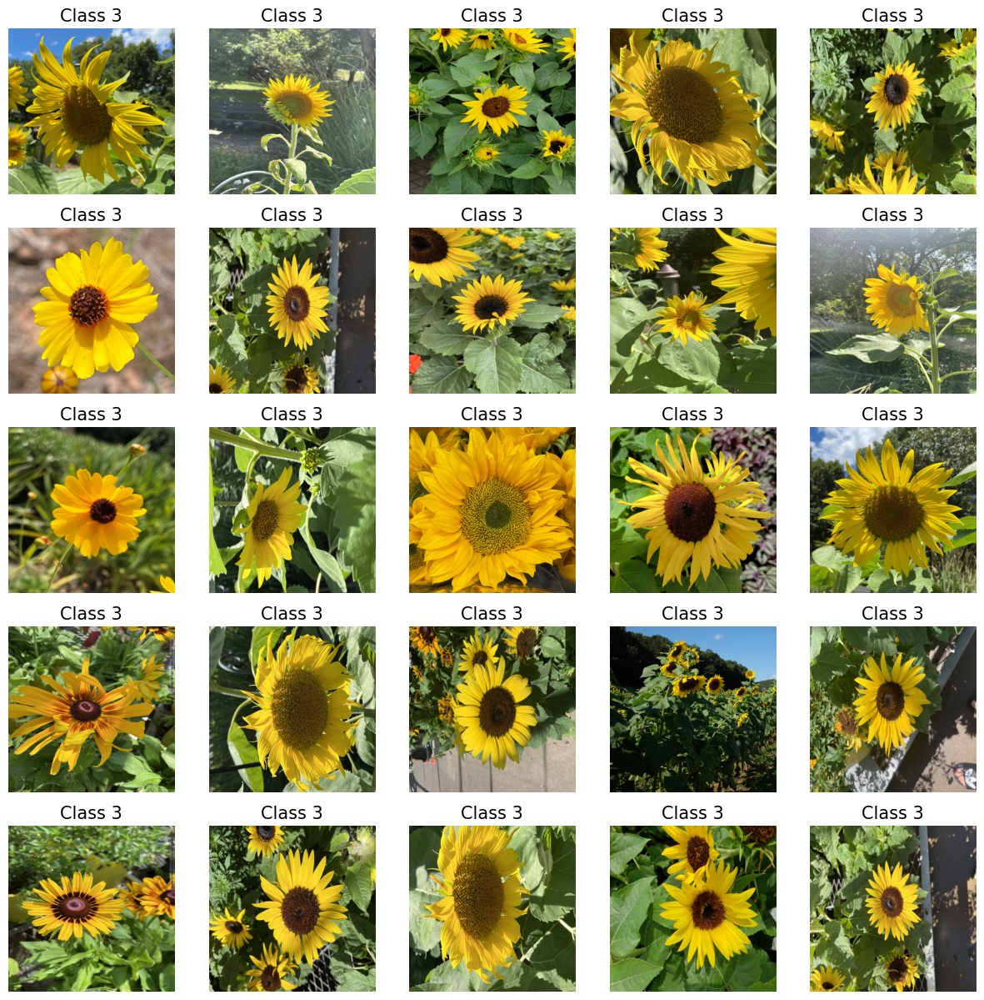

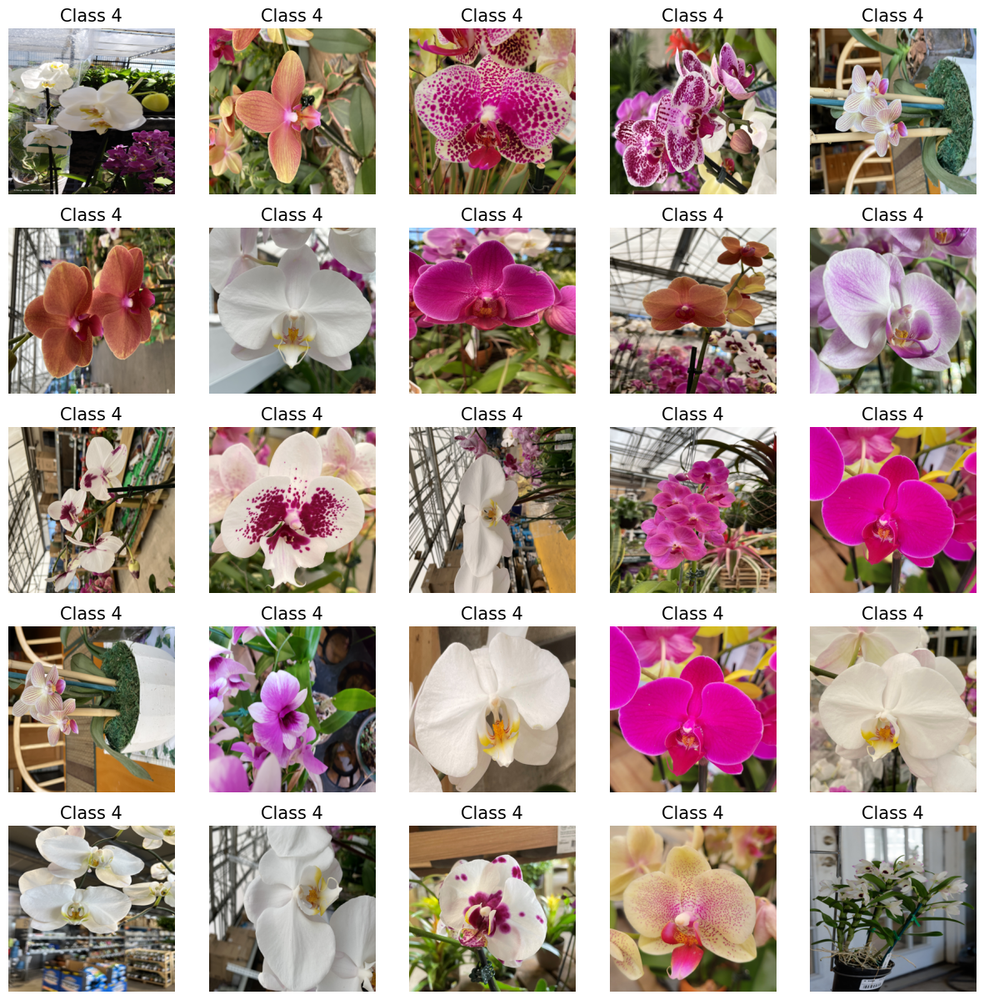

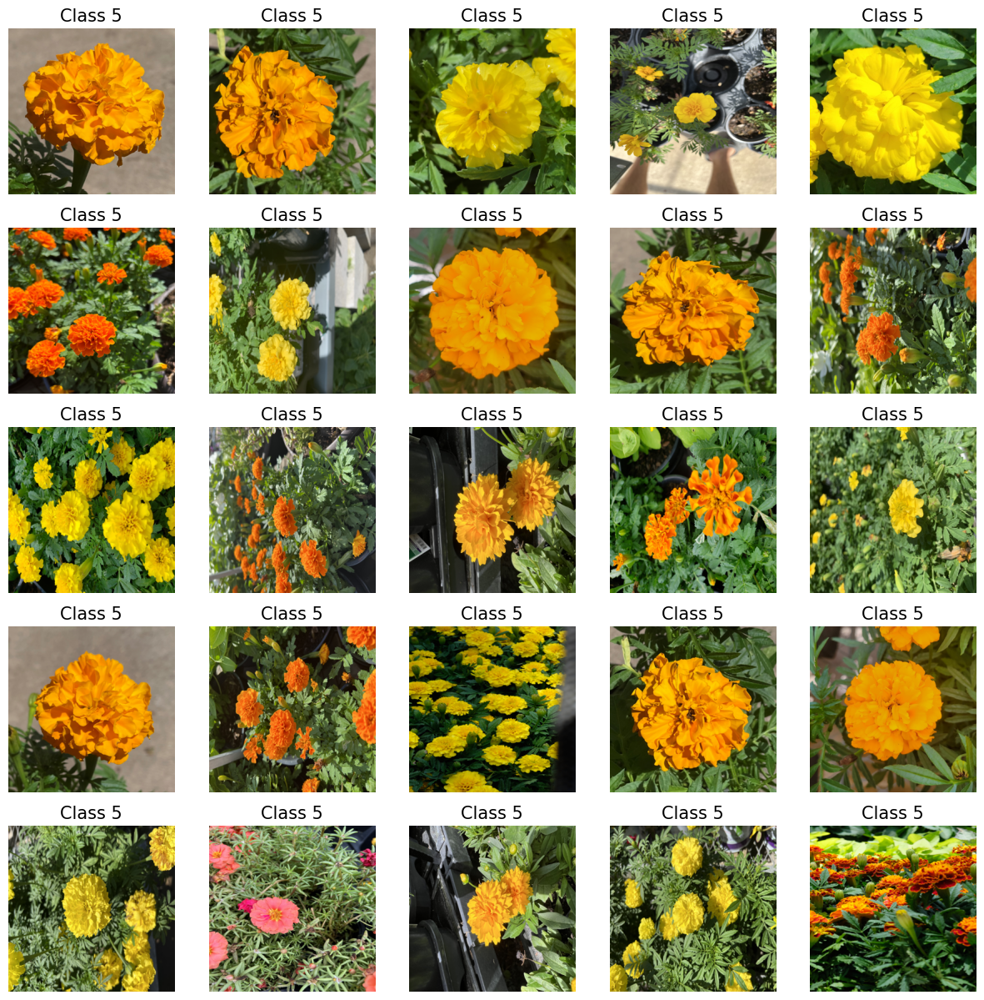

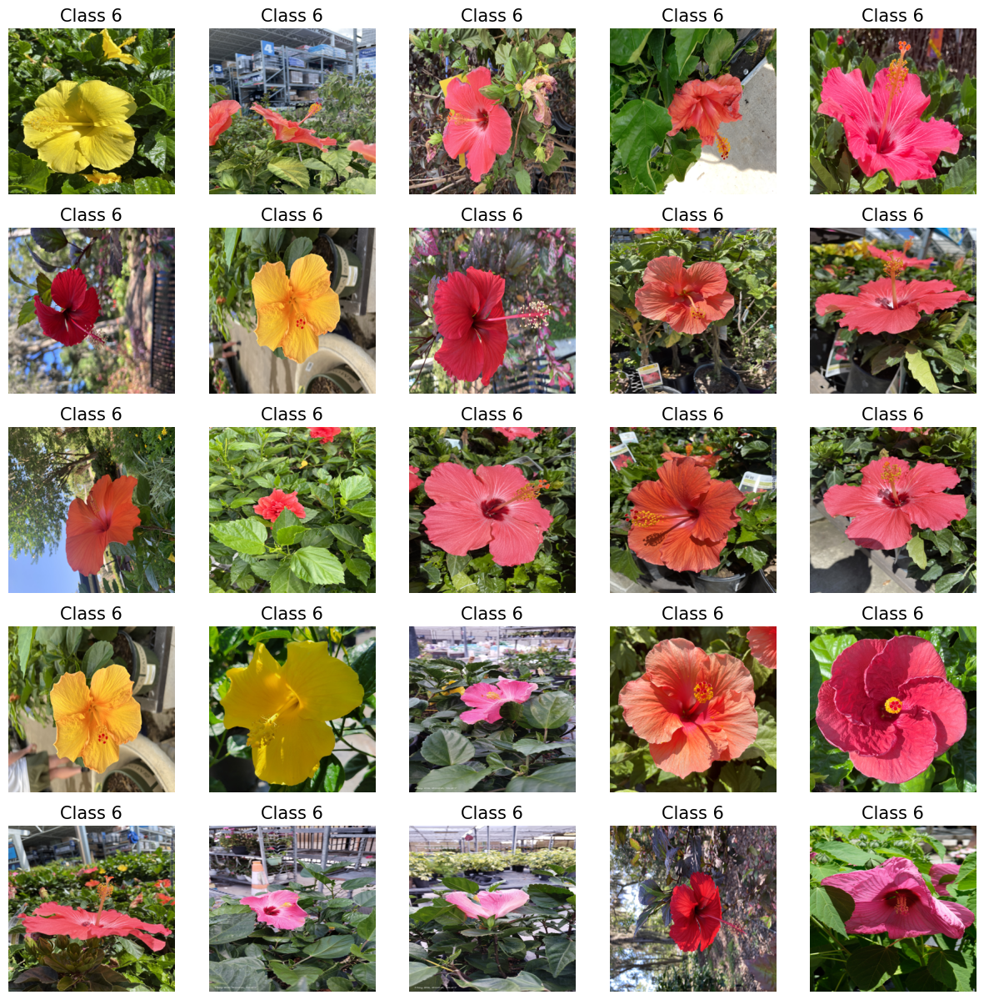

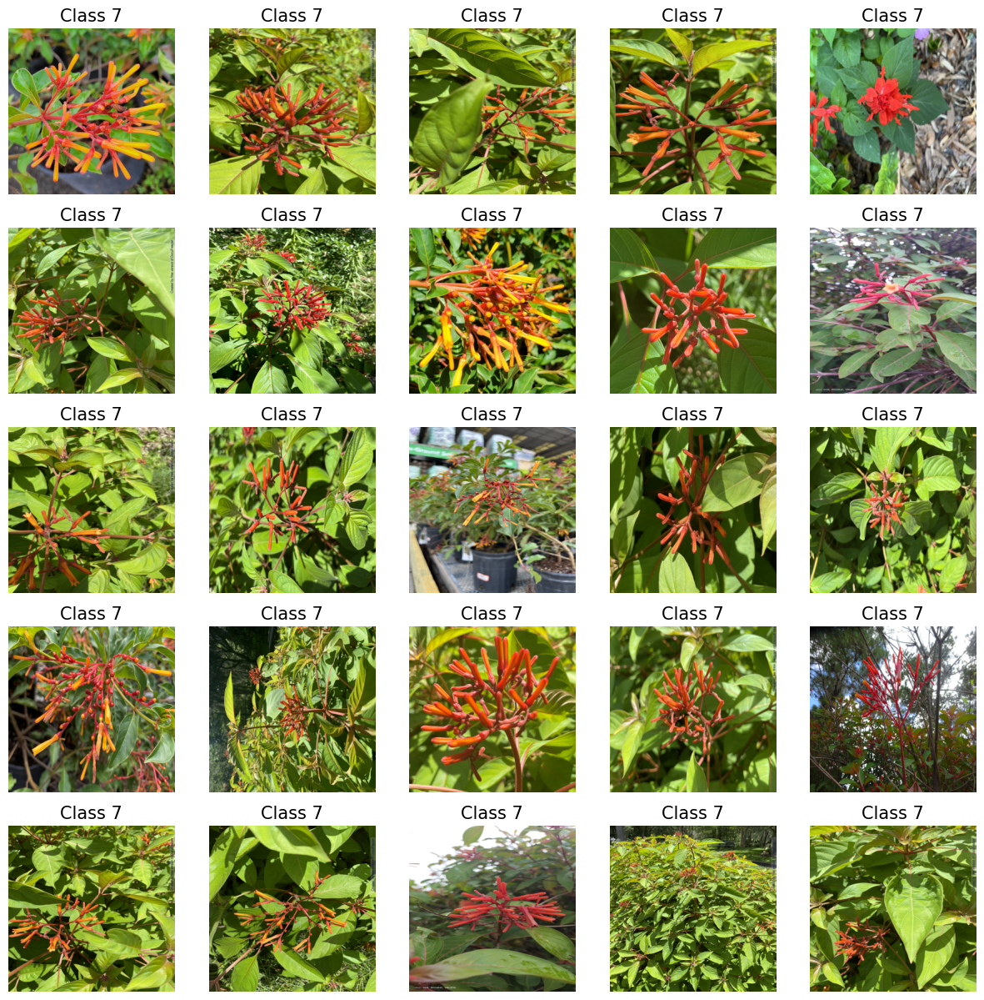

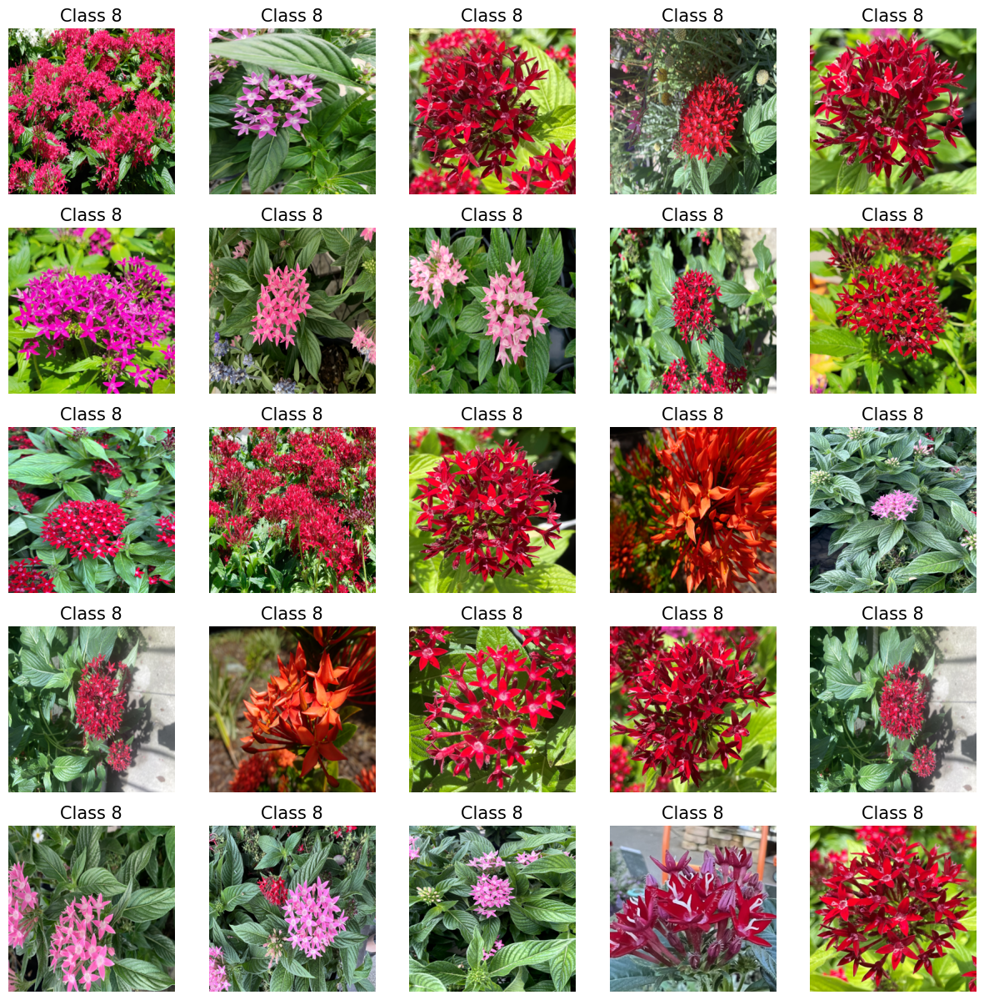

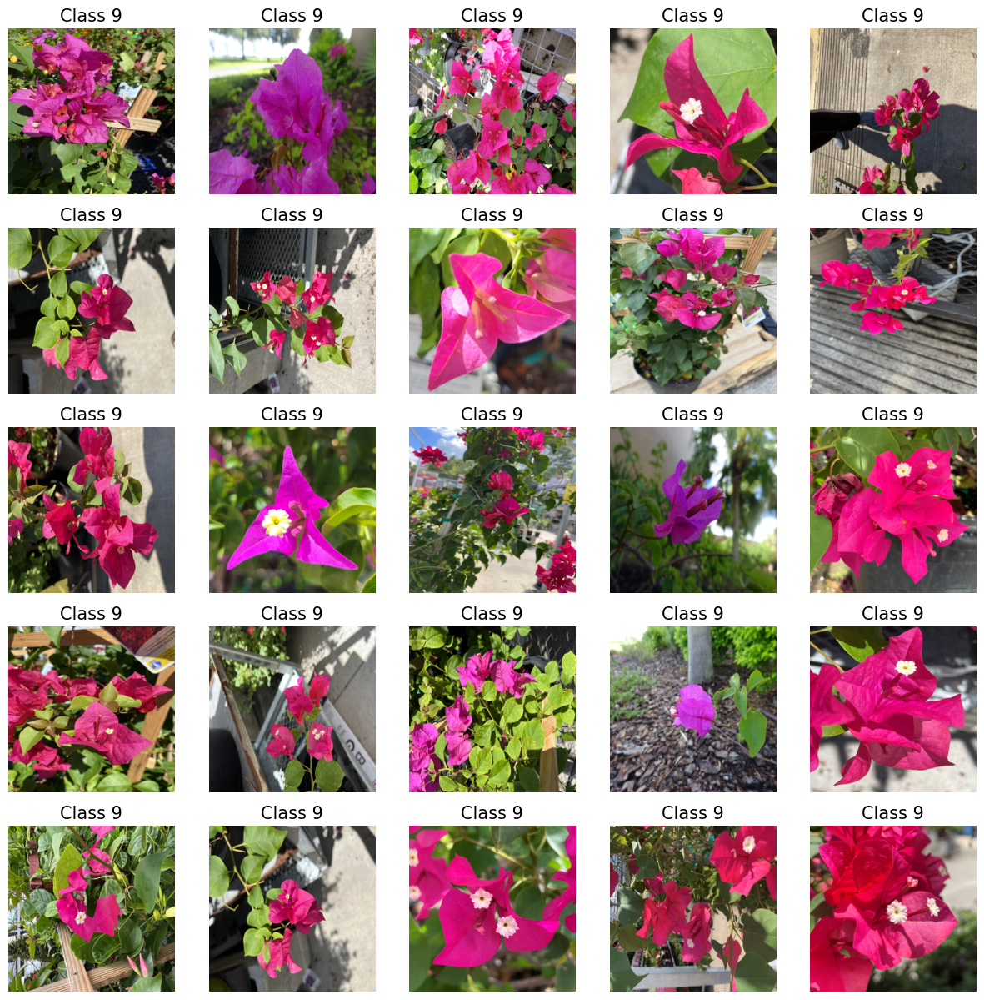

In [3]:
# Displaying some random examples per class

for i in range(0,10):
    rnd_sample = npr.permutation(np.where(t_train_full==i)[0])
    fig=plt.figure(figsize=(15,15))
    for j in range(25):
        fig.add_subplot(5,5,j+1)
        plt.imshow(X_train_full[rnd_sample[j],:].reshape((300,300,3)))
        plt.axis('off');plt.title('Class '+str(int(t_train_full[rnd_sample[j]])),size=15)
    plt.show()
    print('\n\n')

In [32]:
import tensorflow as tf
from tensorflow import keras

# compression with the images from input to the first h layer
model = keras.models.Sequential([
    keras.layers.Flatten(input_shape=[300,300, 3]),
    keras.layers.Dense(300, activation='relu', kernel_initializer='he_normal'),
    keras.layers.LeakyReLU(alpha=(0.2)),
    keras.layers.Dense(600, activation='relu', kernel_initializer='he_normal'),
    keras.layers.Dense(600, activation='relu', kernel_initializer='he_normal'),
    keras.layers.Dense(300, activation='relu', kernel_initializer='he_normal'),
    keras.layers.Dense(10, activation='softmax')
])

In [33]:
model.summary()

Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 flatten_5 (Flatten)         (None, 270000)            0         
                                                                 
 dense_20 (Dense)            (None, 300)               81000300  
                                                                 
 dense_21 (Dense)            (None, 600)               180600    
                                                                 
 dense_22 (Dense)            (None, 600)               360600    
                                                                 
 dense_23 (Dense)            (None, 300)               180300    
                                                                 
 dense_24 (Dense)            (None, 10)                3010      
                                                                 
Total params: 81,724,810
Trainable params: 81,724,810


In [34]:
# opt = keras.optimizers.Nadam(lr=0.01, beta_2=0.08, epsilon=1e-08, clipvalue=5.0)
opt = keras.optimizers.SGD(lr=0.075, momentum=0.9)
model.compile(loss='sparse_categorical_crossentropy',
              optimizer='sgd', # stochastic gradient descent
              metrics=['accuracy'])

In [281]:
keras.optimizers.SGD?

In [7]:
X_train_full = X_train_full.reshape((1658,300,300,3))

X_valid, X_train = X_train_full[:165] / 255.0, X_train_full[165:] / 255.0
t_valid, t_train = t_train_full[:165], t_train_full[165:]


In [8]:
X_train_full.shape, t_train_full.shape

((1658, 300, 300, 3), (1658,))

In [63]:
model.predict(X_valid).shape

6/6 [==============================] - 2s 269ms/step


(165, 10)

In [35]:
history = model.fit(X_train, t_train, epochs=30, batch_size=20,
                   validation_data=(X_valid, t_valid))

Epoch 1/30
75/75 [==============================] - 10s 133ms/step - loss: 2.2961 - accuracy: 0.1855 - val_loss: 2.3011 - val_accuracy: 0.1515
Epoch 2/30
75/75 [==============================] - 9s 124ms/step - loss: 1.8907 - accuracy: 0.2719 - val_loss: 2.1919 - val_accuracy: 0.1455
Epoch 3/30
75/75 [==============================] - 9s 123ms/step - loss: 1.7202 - accuracy: 0.3530 - val_loss: 1.5438 - val_accuracy: 0.3758
Epoch 4/30
75/75 [==============================] - 9s 124ms/step - loss: 1.5361 - accuracy: 0.4099 - val_loss: 1.9690 - val_accuracy: 0.2848
Epoch 5/30
75/75 [==============================] - 9s 123ms/step - loss: 1.4540 - accuracy: 0.4508 - val_loss: 1.6454 - val_accuracy: 0.3333
Epoch 6/30
75/75 [==============================] - 9s 122ms/step - loss: 1.3447 - accuracy: 0.5137 - val_loss: 1.5521 - val_accuracy: 0.4303
Epoch 7/30
75/75 [==============================] - 9s 124ms/step - loss: 1.2909 - accuracy: 0.5432 - val_loss: 1.3423 - val_accuracy: 0.5333
Epoch

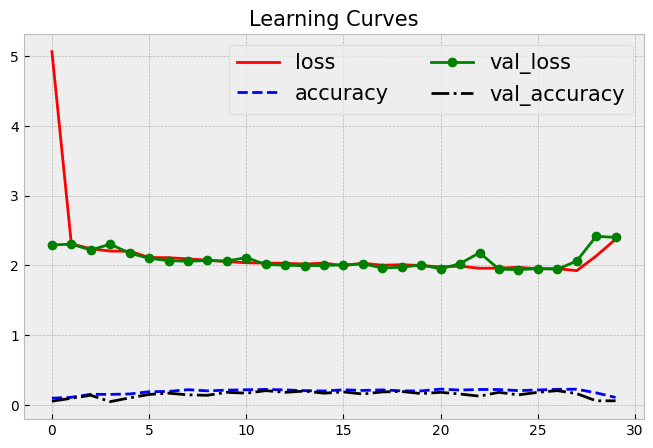

In [15]:
# lr=0.1, momentum=0.9
# optimizers: SGD
# 2 hidden layers (300,300)
# epochs=30, batch_size=32
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

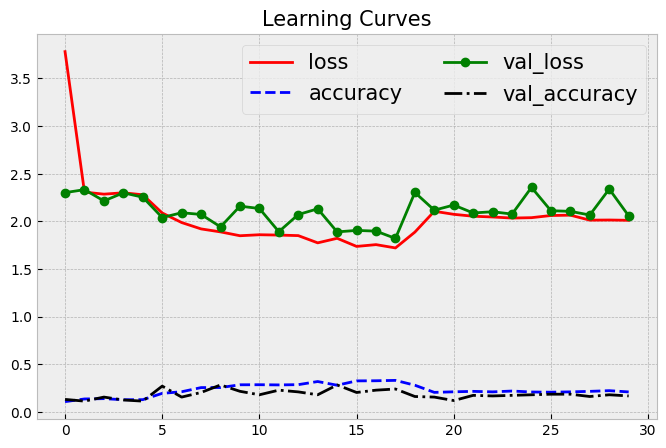

In [10]:
# lr=0.1, momentum=0.9
# optimizers: SGD
# 2 hidden layers (300,600)
# epochs=30, batch_size=32
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

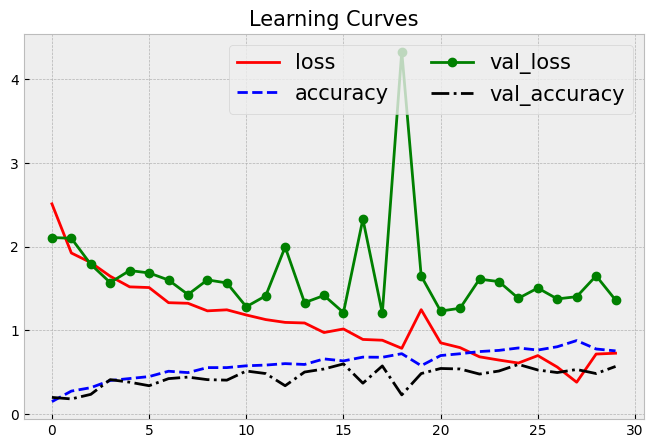

In [20]:
# lr=0.1, momentum=0.9
# optimizers: SGD
# 3 hidden layers (300,600,600)
# epochs=30, batch_size=32
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

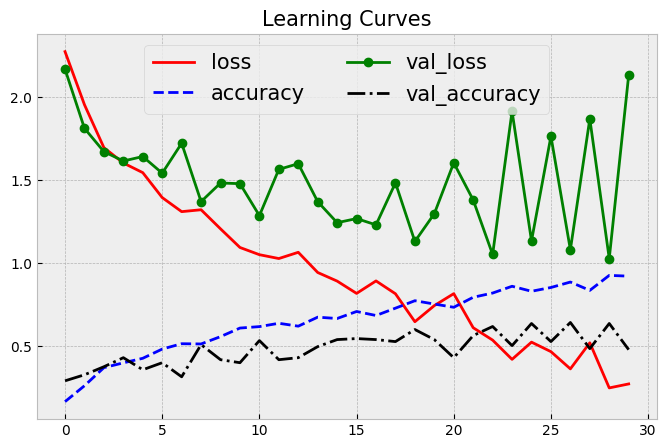

In [25]:
# lr=0.1, momentum=0.9
# optimizers: SGD
# 4 hidden layers (300,600,600,600)
# epochs=30, batch_size=32
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

In [26]:
model.save('./dnn_4_hl_3666.h5')

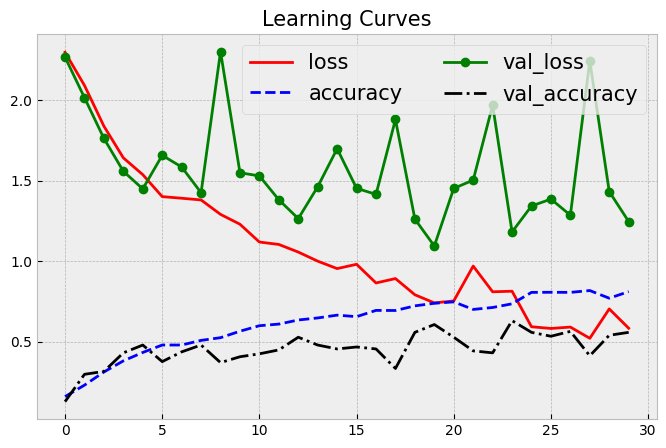

In [31]:
# lr=0.1, momentum=0.9
# optimizers: SGD
# 4 hidden layers (300,600,600,300)
# epochs=30, batch_size=32
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

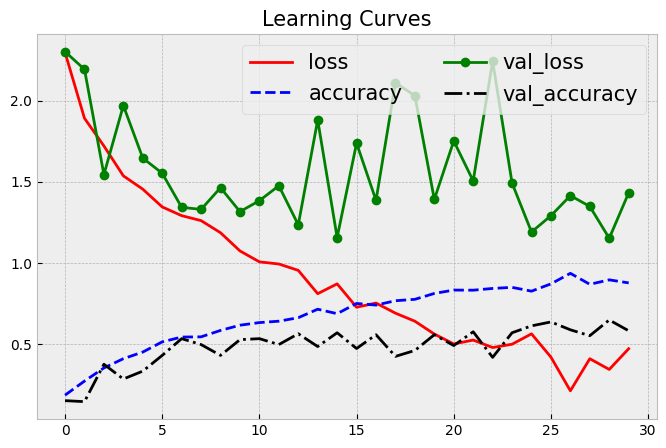

In [36]:
# lr=0.075, momentum=0.9
# optimizers: SGD
# 4 hidden layers (300,600,600,300)
# epochs=30, batch_size=20
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

In [37]:
model.save('./dnn_4_hl_3666_lr0075.h5')

In [68]:
# trainsfer learning
base_model = keras.applications.Xception(
    weights='imagenet',  # Load weights pre-trained on ImageNet.
    input_shape=(150, 150, 3),
    include_top=False)  # Do not include the ImageNet classifier at the top.

base_model.trainable = False

IMG_SIZE = 150
inputs = keras.Input(shape=(300, 300, 3))
inputs_resized = keras.layers.Resizing(IMG_SIZE, IMG_SIZE)(inputs) # 150-150-3
x = base_model(inputs_resized, training=False)
x_pooling = keras.layers.GlobalAveragePooling2D()(x)
outputs = keras.layers.Dense(10, activation='softmax')(x_pooling)
model = keras.Model(inputs, outputs)
model.compile(optimizer=keras.optimizers.Nadam(),
              loss=keras.losses.SparseCategoricalCrossentropy(),
              metrics=['accuracy'])

X_train_rs = tf.constant(X_train.reshape((X_train.shape[0],300,300,3)), dtype=tf.float32)
X_val_rs = tf.constant(X_valid.reshape((X_valid.shape[0],300,300,3)), dtype=tf.float32)

history = model.fit(X_train_rs,t_train, epochs=5, batch_size=32,
                    validation_data=(X_val_rs, t_valid),
                    callbacks=[keras.callbacks.EarlyStopping(patience=30)])

Epoch 1/5
47/47 [==============================] - 69s 1s/step - loss: 0.7087 - accuracy: 0.8031 - val_loss: 0.5986 - val_accuracy: 0.8303
Epoch 2/5
47/47 [==============================] - 68s 1s/step - loss: 0.5731 - accuracy: 0.8506 - val_loss: 0.5162 - val_accuracy: 0.8545
Epoch 3/5
47/47 [==============================] - 69s 1s/step - loss: 0.4889 - accuracy: 0.8694 - val_loss: 0.4958 - val_accuracy: 0.8667
Epoch 4/5
47/47 [==============================] - 69s 1s/step - loss: 0.4296 - accuracy: 0.8969 - val_loss: 0.4627 - val_accuracy: 0.8909
Epoch 5/5
47/47 [==============================] - 69s 1s/step - loss: 0.3819 - accuracy: 0.9069 - val_loss: 0.4526 - val_accuracy: 0.8788


In [279]:
model.save('./transfer_learning_dnn_Xception.h5')

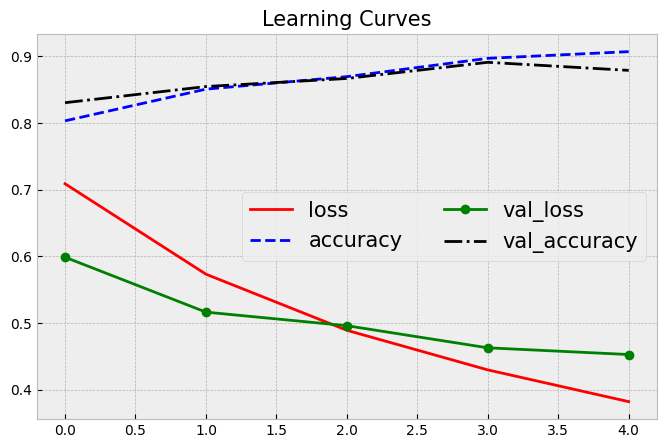

In [69]:
# lr=0.075, momentum=0.9
# optimizers: SGD
# 3 hidden layers (300,600,600,300)
# epochs=30, batch_size=20
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
for i in range(len(key_names)):
    plt.plot(history.history[key_names[i]], colors[i], label=key_names[i])
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

In [ ]:
# Q2 

# Discuss how you would validate performance in the test set given that no target labels are provided. 
# (missing label for the test set?)

# Compare existing car label images with the missing label image (bounding box region), 
# if the pixel pattern is similar (pixel edge has similar shape)

# To address the case where no car is present in the image, the output should be a dot (the added fixed label: [0,0,0,0])

# add a fix target label (e.g. [0,0,0,0]) for all images without a car within it.

# For developing overlapping Region of Interest (ROI), calculating the overlapping areas of intersection 
# between two bounding boxes and divided by the total area of both bounding boxes.

# You may use MakeSenseAI to create your own test labels (a small subset of test samples suffices) to demonstrate your validation metric.

In [29]:
from PIL import Image
import cv2 # install opencv, if you don't already have it (https://pypi.org/project/opencv-python/)
import pandas as pd

bbox = pd.read_csv('car_detection_dataset/train_bounding_boxes.csv')
bbox

,image,xmin,ymin,xmax,ymax
0,vid_4_1000.jpg,281.259045,187.035071,327.727931,223.225547
1,vid_4_10000.jpg,15.163531,187.035071,120.329957,236.430180
2,vid_4_10040.jpg,239.192475,176.764801,361.968162,236.430180
3,vid_4_10020.jpg,496.483358,172.363256,630.020260,231.539575
4,vid_4_10060.jpg,16.630970,186.546010,132.558611,238.386422
...,...,...,...,...,...
554,vid_4_9860.jpg,0.000000,198.321729,49.235251,236.223284
555,vid_4_9880.jpg,329.876184,156.482351,536.664239,250.497895
556,vid_4_9900.jpg,0.000000,168.295823,141.797524,239.176652
557,vid_4_9960.jpg,487.428988,172.233646,616.917699,228.839864


In [30]:
N = len(bbox) # no. of training samples

# Create a numpy array with all images
for i in range(N): 
    filename='car_detection_dataset/training_images/'+bbox['image'][i]
    image = np.array(Image.open(filename))
    image_col = image.ravel()[:,np.newaxis]
    
    if i==0:
        X_train = image_col
    else:
        X_train = np.hstack((X_train, image_col))

# Training feature matrices
X_train = X_train.T

# Training labels
t_train = bbox.drop('image', axis=1).round().to_numpy().astype(int)

X_train.shape, t_train.shape

((559, 770640), (559, 4))

In [31]:
# size of each RGB image
(Nx,Ny,Nz) = image.shape

Nx, Ny, Nz

(380, 676, 3)

In [32]:
def get_overlap_interval(min_ture, min_pred, max_ture, max_pred):
    if min_ture > min_pred:
        if max_ture < max_pred:
            overlap_interval = max_ture - min_ture
        elif min_ture > max_pred:
            overlap_interval = tf.convert_to_tensor(0, dtype=tf.float32)
        else:
            overlap_interval = max_pred - min_ture
    else:
        if max_ture > max_pred:
            overlap_interval = max_pred - min_pred
        elif min_pred > max_ture:
            overlap_interval = tf.convert_to_tensor(0, dtype=tf.float32)
        else:
            overlap_interval = max_ture - min_pred

    return overlap_interval


def custom_metrics(y_true, y_pred):
    roi_list = []
    total_overlap_area = tf.convert_to_tensor(0, dtype=tf.float32)
    total_two_bbox_area = tf.convert_to_tensor(0, dtype=tf.float32)

    idx_bbox = 0
    for item_true in y_true:
        xmin_ture = item_true[0]
        xmin_pred = y_pred[idx_bbox][0]
        xmax_ture = item_true[2]
        xmax_pred = y_pred[idx_bbox][2]

        ymin_ture = item_true[1]
        ymin_pred = y_pred[idx_bbox][1]
        ymax_ture = item_true[3]
        ymax_pred = y_pred[idx_bbox][3]

        x_overlap_interval = get_overlap_interval(xmin_ture, xmin_pred, xmax_ture, xmax_pred)
        y_overlap_interval = get_overlap_interval(ymin_ture, ymin_pred, ymax_ture, ymax_pred)

        overlap_area = x_overlap_interval * y_overlap_interval
        two_bbox_area = (xmax_ture - xmin_ture) * (ymax_ture - ymin_ture) + (xmax_pred - xmin_pred) * (ymax_pred - ymin_pred)
        if idx_bbox == 0:
            total_overlap_area = overlap_area
            total_two_bbox_area = two_bbox_area
        else:
            total_overlap_area += overlap_area
            total_two_bbox_area += two_bbox_area
        idx_bbox += 1
    roi = total_overlap_area/total_two_bbox_area

    return roi

# class EarlyStopByCustomMetrics(keras.callbacks.Callback):
#     def __init__(self, validation_data, value = 0, verbose = 0, patience = 50):
#         super(keras.callbacks.Callback, self).__init__()
#         self.value = value
#         self.verbose = verbose
#         self.validation_data = validation_data
#         self.patience = patience


#     def on_epoch_end(self, epoch, logs={}):
#          predict = np.asarray(self.model.predict(self.validation_data[0]))
#          target = self.validation_data[1]
#          score = custom_metrics(target, predict)
#          if score > self.value:
#             if self.verbose >0:
#                 print("Epoch %05d: early stopping Threshold" % epoch)
#             self.model.stop_training = True


In [33]:
from sklearn.model_selection import train_test_split
X_train, X_valid, t_train, t_valid = train_test_split(X_train, 
                                                  t_train, 
                                                  shuffle=True,
                                                  test_size=0.2)

In [36]:
import tensorflow as tf
from tensorflow import keras

base_model_od = keras.applications.Xception(
    weights='imagenet',  # Load weights pre-trained on ImageNet.
    input_shape=(190, 338, 3),
    include_top=False)  # Do not include the ImageNet classifier at the top.

base_model_od.trainable = False
base_model_od.layers[-3].trainable = True
base_model_od.layers[-2].trainable = True
base_model_od.layers[-1].trainable = True

inputs_od = keras.Input(shape=(380, 676, 3))
inputs_resized_od = keras.layers.Resizing(190, 338)(inputs_od) # 150-150-3
x_od = base_model_od(inputs_resized_od, training=False)
x_pooling_od = keras.layers.GlobalAveragePooling2D()(x_od)
outputs_od = keras.layers.Dense(4, activation='relu')(x_pooling_od)
model_od = keras.Model(inputs_od, outputs_od)
model_od.compile(optimizer=keras.optimizers.Nadam(learning_rate=0.1),
              loss=keras.losses.MeanSquaredError(),
              metrics=[custom_metrics])

# X_train_rs = tf.constant(X_train.reshape((X_train.shape[0],380,676,3)), dtype=tf.float32)
# X_val_rs = tf.constant(X_valid.reshape((X_valid.shape[0],380,676,3)), dtype=tf.float32)

X_train_rs = X_train.reshape((X_train.shape[0],380,676,3))
X_val_rs = X_valid.reshape((X_valid.shape[0],380,676,3))

t_train = tf.convert_to_tensor(t_train, dtype=tf.float32)
t_valid = tf.convert_to_tensor(t_valid, dtype=tf.float32)


In [24]:
history = model_od.fit(X_train_rs,t_train, epochs=50, batch_size=20,
                    validation_data=(X_val_rs, t_valid),
                    callbacks=[keras.callbacks.EarlyStopping(monitor='val_loss', patience=5)])

Epoch 1/50
23/23 [==============================] - 76s 3s/step - loss: 55106.7656 - custom_metrics: 0.5534 - val_loss: 58656.4570 - val_custom_metrics: 0.6167
Epoch 2/50
23/23 [==============================] - 76s 3s/step - loss: 54945.8555 - custom_metrics: 0.5789 - val_loss: 58848.8750 - val_custom_metrics: 0.5946
Epoch 3/50
23/23 [==============================] - 76s 3s/step - loss: 54708.2070 - custom_metrics: 0.6005 - val_loss: 58784.5000 - val_custom_metrics: 0.8781
Epoch 4/50
23/23 [==============================] - 76s 3s/step - loss: 54557.1719 - custom_metrics: 0.6412 - val_loss: 58046.3477 - val_custom_metrics: 0.5961
Epoch 5/50
23/23 [==============================] - 76s 3s/step - loss: 54584.3906 - custom_metrics: 0.6179 - val_loss: 58469.8828 - val_custom_metrics: 0.9022
Epoch 6/50
23/23 [==============================] - 77s 3s/step - loss: 54343.4766 - custom_metrics: 0.6762 - val_loss: 57983.9453 - val_custom_metrics: 0.6629
Epoch 7/50
23/23 [======================

In [25]:
model_od.save('./dnn_custom_metrics_val_loss.h5')

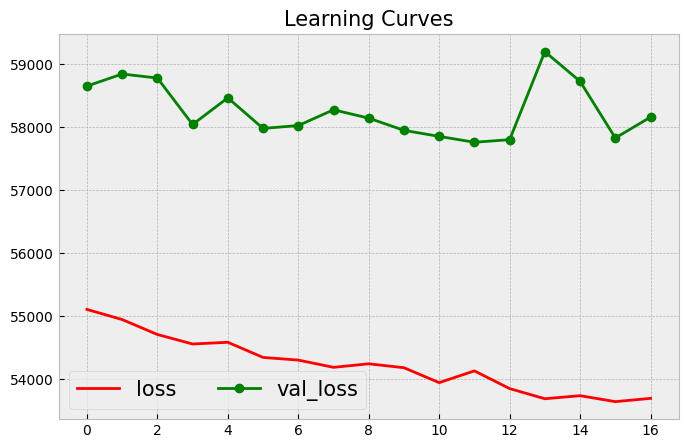

In [42]:
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
plt.plot(history.history['loss'], '-r', label='loss')
plt.plot(history.history['val_loss'], '-og', label='val_loss')
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);

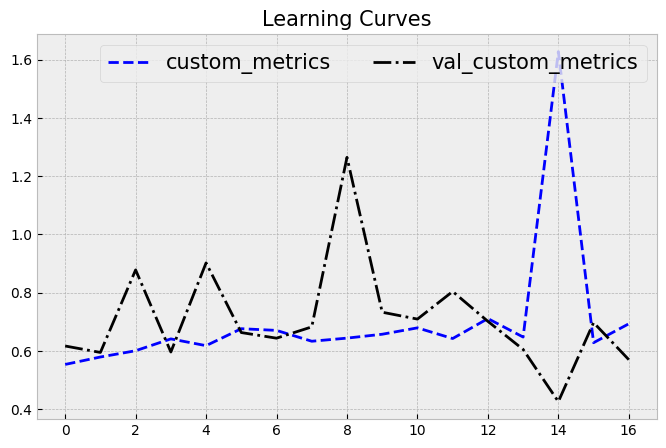

In [43]:
key_names = list(history.history.keys())
colors = ['-r','--b','-og','-.k']

plt.figure(figsize=(8,5))
plt.plot(history.history['custom_metrics'], '--b', label='custom_metrics')
plt.plot(history.history['val_custom_metrics'], '-.k', label='val_custom_metrics')
plt.legend(fontsize=15,ncol=2)
plt.title('Learning Curves', size=15);